### Задание № 9


#### Тема: Автокодировщики

### Задание Ultra Lite

Перепишите автокодировщик Mnist “с нуля”  в новом ноутбуке. Можно подсматривать в ноутбук занятия, но крайне желательно писать код своими руками, а не копировать.

### Задание Lite




Используйте готовый ноутбук с занятия:
1. Обучите автокодировщик на 10 выбранных вами красивых цифрах 5 и отредактируйте с помощью него все остальные цифры 5
2. Напишите 3 автокодировщика для подавления шума с собственными архитектурами. Сравните их между собой и с исходным шумоподавляющим атокодировщиком. Сравнивайте по квадрату разности исходной картинки с востановленной из шума
3. Обучите автокодировщик на базе Fashion Mnist, проверьте, как он преобразует картинки одежды, на которых не обучался


### Задание Pro




Добейтесь средней точности 91-92% в задаче поиска мошеннических операций. Для этого попробуйте сделать более мощный автокодировщик и гибкую настройку порога (bias), по которому мы определяем, мошенническая транзакция или нет

Постройте на одном графике 2 гистограммы (density=True) для нормальных и мошеннических транзакций. По графику определите 3 порога:
1) при котором все мошеннические транзакции будут пойманы
2) “оптимальный порог” - на пересечении распределений
3) при котором ни одна нормальная транзакция не будет распознана, как мошенническая


### Задание Ultra pro




Возьмите любую базу картинок (Mnist, Fashion Mnist, Cifar10 или собственную)

На картинках в случайных местах сделайте чёрные квадраты разного размера.

Обучите автокодировщик восстанавливать контент картинок, который скрыт чёрными квадратами

*работать может неидеально

**это не совсем автокодировщик, так как у автокодировщика вход строго равен выходу, но архитектура очень близкая к автокодировщику

#### 1. Импорт библиотек.

In [65]:
from tensorflow.keras.models import Model, Sequential 
from tensorflow.keras.layers import Dense, Flatten, Reshape, Input, Conv2DTranspose, concatenate, Activation, MaxPooling2D, Conv2D, BatchNormalization
from tensorflow.keras import backend as K # базовые керасовские функции
from tensorflow.keras.optimizers import Adam 
from tensorflow.keras import utils 
from tensorflow.keras.datasets import mnist, fashion_mnist 
from tensorflow.keras.callbacks import LambdaCallback
import matplotlib.pyplot as plt 
from tensorflow.keras.preprocessing import image 
import numpy as np 
import pandas as pd
from PIL import Image
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import StandardScaler 
import os 
import time, random
import seaborn as sns
sns.set_style('darkgrid')
import warnings
warnings.filterwarnings("ignore")

In [66]:
def baseAutoencoder(shape=(112,80,1)): 
    img_input = Input((shape)) # задаём входные размеры

    x = Conv2D(32, (3, 3), padding='same', activation='relu')(img_input) # входные данные передаем на слой двумерной свёртки
    x = BatchNormalization()(x) # затем пропускаем через слой нормализации данных 
    x = Conv2D(32, (3, 3), padding='same', activation='relu')(x) # далее снова слой двумерной свёртки
    x = BatchNormalization()(x)
    x = MaxPooling2D()(x) # передаём на слой подвыборки, снижающий размерность поступивших на него данных

    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x) # передаем на слой двумерной свёртки
    x = BatchNormalization()(x) # пропускаем через слой нормализации данных 
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)  # далее снова слой двумерной свёртки
    x = BatchNormalization()(x) 
    z = MaxPooling2D()(x) # передаём на слой подвыборки
    

    x = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same', activation='relu')(z) # слой разжимает данные(с 28*20 на 56*40)
    x = BatchNormalization()(x) 
    
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x) # передаем на слой двумерной свёртки
    x = BatchNormalization()(x) 
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x) 
    x = BatchNormalization()(x) 
    # Сжатие MaxPooling2D не применяем

    x = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same', activation='relu')(x) # слой разжимает данные(с 56*40 на 112*80)
    x = BatchNormalization()(x) 
    x = Conv2D(32, (3, 3), padding='same', activation='relu')(x) 
    x = BatchNormalization()(x) 
    x = Conv2D(32, (3, 3), padding='same', activation='relu')(x) 
    x = BatchNormalization()(x) 

    # Финальный слой двумерной свертки, выдающий итоговое изображение
    x = Conv2D(shape[-1], (3, 3), activation='sigmoid', padding='same')(x)

    model = Model(img_input, x) # указываем модель, с оригинальным изображением на входе в сеть и сжатым-разжатым на выходе из сети
    model.compile(optimizer=Adam(lr=0.0001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

    return model 

In [67]:
def plotImages(xTrain, pred, shape=(112, 80)): # функ. для вывода изображений как картинок
  n = 5  # количество картинок, которые хотим показать
  plt.figure(figsize=(14, 7)) 
  for i in range(n): 
      index = np.random.randint(0, pred.shape[0]) # startIndex - начиная с какого индекса хотим заплотить картинки
      # Показываем картинки из тестового набора
      ax = plt.subplot(2, n, i + 1) # выведем область рисования Axes
      plt.imshow(xTrain[index].reshape(shape)) # отрисуем правильные картинки в размере 112*80      
      plt.gray() # выведем в черно-белом цвете
      ax.get_xaxis().set_visible(False) # скрываем вывод координатной оси x
      ax.get_yaxis().set_visible(False) # скрываем вывод координатной оси y

      # Показываем восстановленные картинки
      ax = plt.subplot(2, n, i + 1 + n) # выведем область рисования Axes 
      plt.imshow(pred[index].reshape(shape)) # отрисуем обработанные сеткой картинки в размере 112*80     
      plt.gray() # выведем в черно-белом цвете
      ax.get_xaxis().set_visible(False) # скрываем вывод координатной оси x
      ax.get_yaxis().set_visible(False) # скрываем вывод координатной оси y
  plt.show()

In [68]:
def getMSE(x1, x2): # Функция для расчета mse
  x1 = x1.flatten() # сплющиваем в одномерный вектор
  x2 = x2.flatten() # сплющиваем в одномерный вектор
  delta = x1 - x2 
  return sum(delta ** 2) / len(delta) # и возвращаем сумму квадратов разницы, делённую на длину разницы

In [69]:
(xTrainMnist, yTrainMnist), (xTestMnist, yTestMnist) = mnist.load_data()
xTrainMnist = xTrainMnist.astype('float32')/255 # представляем в виде значений от 0 до 1
xTrainMnist = xTrainMnist.reshape(-1, 28, 28, 1) 
xTestMnist = xTestMnist.astype('float32')/255 
xTestMnist = xTestMnist.reshape(-1, 28, 28, 1) # меняем форму, приводим к нужным нам размерам

In [70]:
xTrainMnist.shape 

(60000, 28, 28, 1)

In [71]:
modelAutoMnist = baseAutoencoder((28,28,1)) # создаем автокодировщик

In [72]:
modelAutoMnist.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 28, 28, 1)]       0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 28, 28, 32)        320       
_________________________________________________________________
batch_normalization_10 (Batc (None, 28, 28, 32)        128       
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 28, 28, 32)        9248      
_________________________________________________________________
batch_normalization_11 (Batc (None, 28, 28, 32)        128       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 14, 14, 64)        1849

In [73]:
utils.plot_model(modelAutoMnist, dpi=60, show_shapes=True)

('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [74]:
history = modelAutoMnist.fit(xTrainMnist, xTrainMnist, epochs=3, batch_size=256, validation_data = (xTestMnist, xTestMnist))

Epoch 1/3
235/235 [==============================] - 281s 1s/step - loss: 0.0679 - val_loss: 0.0984
Epoch 2/3
235/235 [==============================] - 280s 1s/step - loss: 0.0144 - val_loss: 0.0123
Epoch 3/3
235/235 [==============================] - 20839s 89s/step - loss: 0.0085 - val_loss: 0.0066


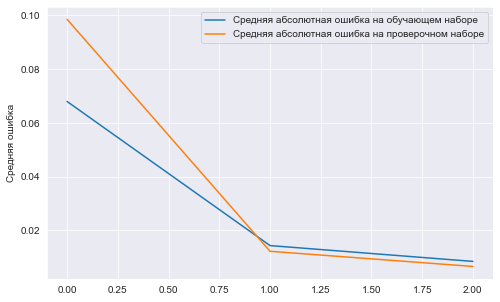

In [75]:
plt.figure(figsize=(8,5))
plt.plot(history.history['loss'][0:], 
         label='Средняя абсолютная ошибка на обучающем наборе')
plt.plot(history.history['val_loss'][0:], 
         label='Средняя абсолютная ошибка на проверочном наборе')
plt.ylabel('Средняя ошибка')
plt.legend()
plt.show()

In [76]:
modelAutoMnist.save_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelAutoMnist.h5') 
modelAutoMnist.load_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelAutoMnist.h5') 

In [77]:
predMnistTest = modelAutoMnist.predict(xTestMnist) 
predMnistTest = predMnistTest * 255 # представляем в виде значений от 0 до 255
predMnistTest = predMnistTest.astype('uint8') # устанавливаем 8битовый тип

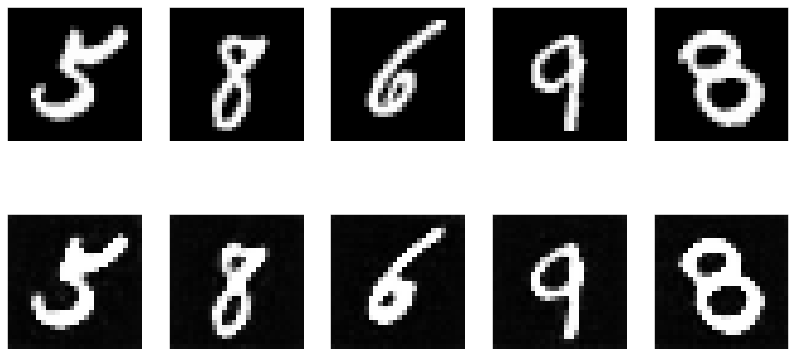

In [79]:
plotImages(xTestMnist, predMnistTest, shape=(28,28)) # покажем исходные и восстановленные картинки

In [80]:
predMnistTrain = modelAutoMnist.predict(xTrainMnist)
predMnistTrain = predMnistTrain * 255 
predMnistTrain = predMnistTrain.astype('uint8') 

In [81]:
# Возьмем среднеквадратичную ошибку от правильной картинки и восстановленной (обучающая выборка)
err1 = [getMSE(xTrainMnist[i], predMnistTrain[i] / 255) for i in range(len(predMnistTrain))]
# (тестовая выборка)
err2 = [getMSE(xTestMnist[i], predMnistTest[i] / 255) for i in range(len(predMnistTest))]
print("Средняя ошибка на обучающем наборе MNIST:", sum(err1) / xTrainMnist.shape[0]) 
print("Средняя ошибка на тестовом наборе MNIST:", sum(err2) /xTestMnist.shape[0] ) 

Средняя ошибка на обучающем наборе MNIST: 0.0066562766495639
Средняя ошибка на тестовом наборе MNIST: 0.006515642153266226


#### Fashion_mnist



In [82]:
# fashion_mnist - базa с одеждой,обувью и т.п
(xTrainMnistF, yTrainMnistF), (xTestMnistF, yTestMnistF) = fashion_mnist.load_data()
xTrainMnistF = xTrainMnistF.astype('float32')/255 # представляем в виде значений от 0 до 1
xTrainMnistF = xTrainMnistF.reshape(xTrainMnistF.shape[0], 28, 28, 1) # приводим к нужным размерам

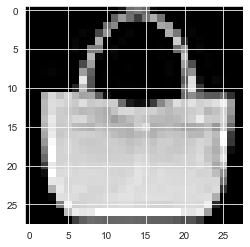

In [83]:
n = 100 # выбираем картинку
plt.imshow(xTrainMnistF[n].reshape((28,28)), cmap='gray') # переводим в 4х-канальное цветовое пространство RGBA
plt.show() 

In [84]:
predMnistF = modelAutoMnist.predict(xTrainMnistF) # для первых ста картинок из fashion_mnist
predMnistF = predMnistF * 255 # представляем в виде значений от 0 до 255
predMnistF = predMnistF.astype('uint8') # устанавливаем 8битовый тип

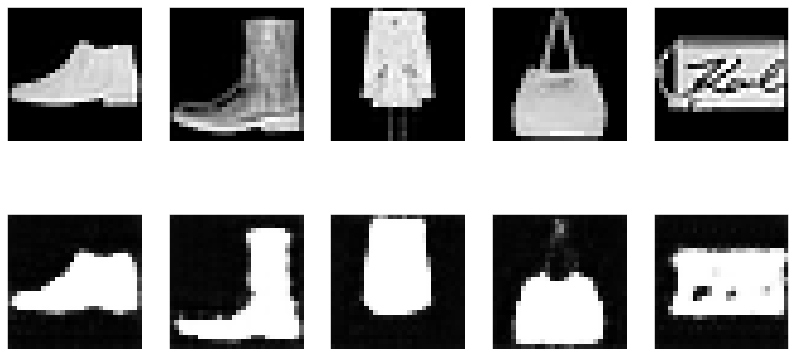

In [85]:
plotImages(xTrainMnistF, predMnistF, shape=(28,28)) #картинки правильных и восстановленных изображений 

In [86]:
errF = [getMSE(xTrainMnistF[i], predMnistF[i] / 255) for i in range(len(predMnistF))]
print("Средняя ошибка на Mnist:", round(sum(err1) / len(err1), 4))
print("Средняя ошибка на одежде:", round(sum(errF) / len(errF), 4))
print()
print("Максимальная ошибка на Mnist:", round(max(err1),4))
print("Минимальная ошибка на одежде:", round(min(errF),4))

Средняя ошибка на Mnist: 0.0067
Средняя ошибка на одежде: 0.0413

Максимальная ошибка на Mnist: 0.0274
Минимальная ошибка на одежде: 0.0026


In [87]:
bias = 0.0012 # установим какое-то пороговое значение
isMnist = [e < bias for e in err1] # запишем каждую ошибку больше порогового значения, Mnist
isMnistF = [e < bias for e in errF] # запишем каждую ошибку больше порогового значения, fashion_mnist

print("Mnist распознано, как Mnist: ", round(100*sum(isMnist) / len(isMnist), 2),"%", sep="")
print("Одежды распознано, как Mnist: ", round(100*sum(isMnistF) / len(isMnistF), 2),"%", sep="")
print("Суммарная ошибка: ", round(100*(1-(sum(isMnist) / len(isMnist)) + sum(isMnistF) / len(isMnistF))),"%", sep="")

Mnist распознано, как Mnist: 0.0%
Одежды распознано, как Mnist: 0.0%
Суммарная ошибка: 100%


#### Визуализация

In [88]:
def create_dense_ae(latent_dim): # объявляем функцию создания автокодировщика
    # Энкодер
    # Входной плейсхолдер
    input_img = Input(shape=(28, 28, 1)) # 28, 28, 1 - размерности строк, столбцов, фильтров одной картинки, без батч-размерности
    # Вспомогательный слой решейпинга
    flat_img = Flatten()(input_img)    
    # Кодированное полносвязным слоем представление
    encoded = Dense(latent_dim, activation='relu')(flat_img)    
    # Декодер
    # Раскодированное другим полносвязным слоем изображение
    input_encoded = Input(shape=(latent_dim,)) # задаем входную размерность (49,)
    flat_decoded = Dense(28*28, activation='sigmoid')(input_encoded) # далее полносвязный слой на 784 нейрона
    decoded = Reshape((28, 28, 1))(flat_decoded) # меняем форму, приводим к нужным нам размерам
    # Модели, в конструктор первым аргументом передаются входные слои, а вторым выходные слои
    # Другие модели можно так же использовать как и слои
    encoder = Model(input_img, encoded, name="encoder")    
    decoder = Model(input_encoded, decoded, name="decoder")    
    # Построим модель автокодировщика (внутри двойное преобразование - сжатие/разжатие)
    autoencoder = Model(input_img, decoder(encoder(input_img)), name="autoencoder")
    return encoder, decoder, autoencoder # функция вернет 3 собранные сетки

In [89]:
def on_epoch_end_AE(epoch, logs):
  print('________________________')  
  print('*** ЭПОХА:', epoch+1,'***')
  print('________________________')  
  plt.figure(figsize=(12,12))
  predict = encoder.predict(new_x_train)
  scatter = plt.scatter(predict[:,0,],predict[:,1], c=new_y_train, alpha=0.6)
  legend2 = plt.legend(*scatter.legend_elements(),loc="upper right", title="Классы")
  #plt.axis('off')
  plt.savefig('image'+str(epoch)+'.jpg')
  plt.show()
  print('loss: ', logs['loss'])

pltAE = LambdaCallback(on_epoch_end=on_epoch_end_AE)

In [31]:
#pip install pydot

Note: you may need to restart the kernel to use updated packages.


In [91]:
pip install graphviz

Note: you may need to restart the kernel to use updated packages.


In [92]:
encoder, decoder, autoencoder = create_dense_ae(2) # создаем три сетки с помощью заданной ранее функции
print('Схема автокодировщика:')
utils.plot_model(autoencoder, show_shapes=True, dpi=70)

Схема автокодировщика:
('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [93]:
print('Схема энкодера:')
utils.plot_model(encoder, show_shapes=True, dpi=70)

Схема энкодера:
('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [94]:
print('Схема декодера:')
utils.plot_model(decoder, show_shapes=True, dpi=70)

Схема декодера:
('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


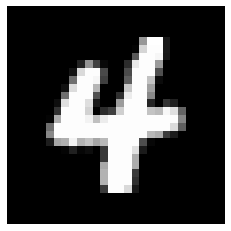

In [95]:
test_img = xTestMnist[np.random.randint(len(xTestMnist))] #случайное изображение из тестовой выборки
plt.imshow(test_img.reshape(28,28), cmap='gray') 
plt.axis('off') # Отклюачем подписи осей
plt.show()

[[0.         0.38796833]]


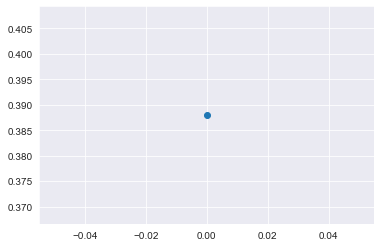

In [96]:
koord = encoder.predict(test_img[None,...]) # Подаем изображение в декодер и получаем предикт (две координаты)
print(koord) 
scatter = plt.scatter(koord[0,0,],koord[0,1]) # Рисуем точку на плоскости
plt.show()

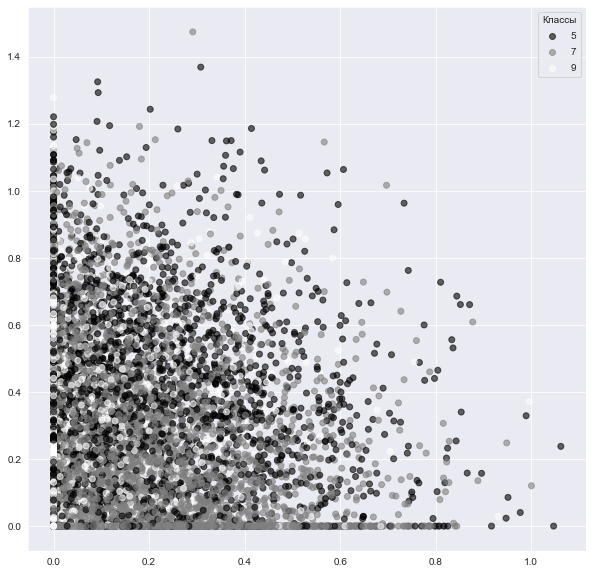

In [97]:
numbers = [5, 7, 9] # Задаем цифры для визуализации
mask = np.array([(i in numbers) for i in yTrainMnist]) # Создаем маску по выбранным цифрам
new_x_train = xTrainMnist[mask] # Выбираем из xTrain только картики по маске
new_y_train = yTrainMnist[mask] # Выбираем из yTrain только метки по маске
plt.figure(figsize=(10,10)) 
predict = encoder.predict(new_x_train) # Получаем предсказание энкодера
scatter = plt.scatter(predict[:,0,],predict[:,1], c=new_y_train, alpha=0.6) # Выводим точки для всех изображений
legend2 = plt.legend(*scatter.legend_elements(),loc="upper right", title="Классы") # Выводим легенду
plt.show()

________________________
*** ЭПОХА: 1 ***
________________________


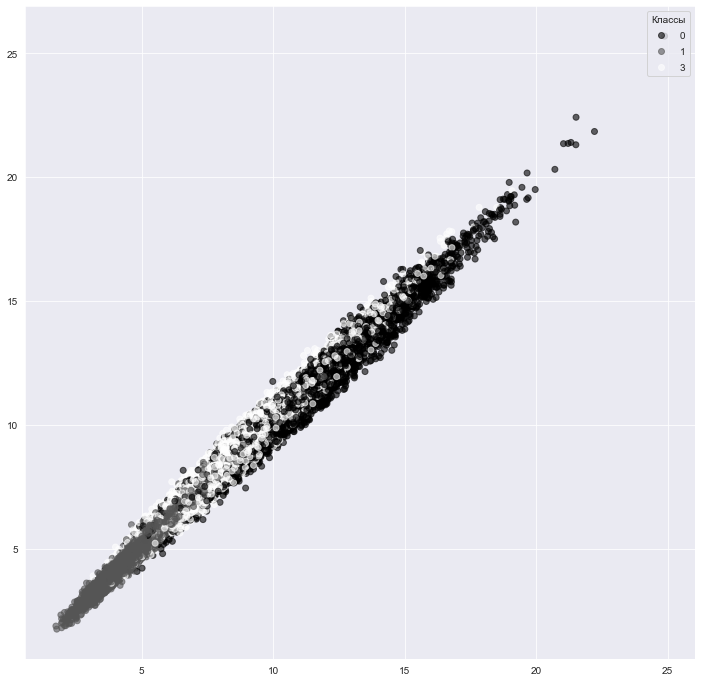

loss:  0.5785238742828369
________________________
*** ЭПОХА: 2 ***
________________________


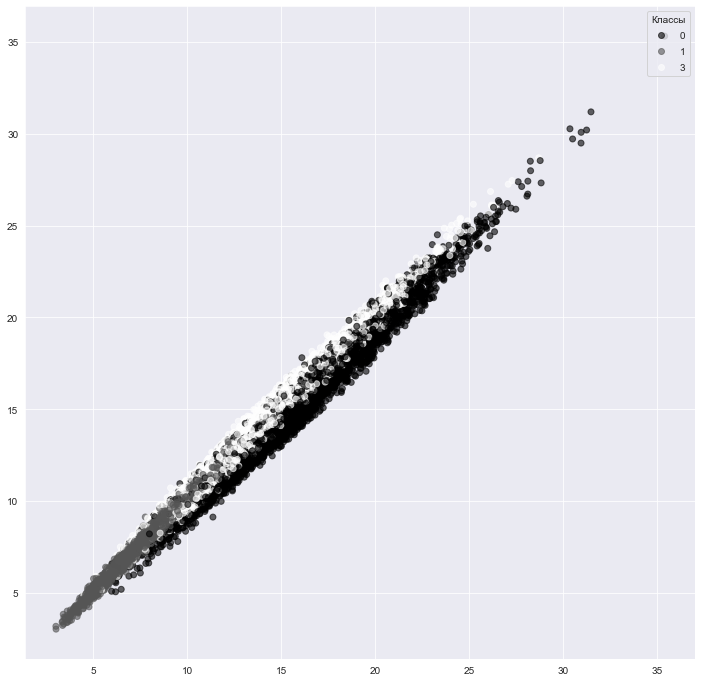

loss:  0.3302978575229645
________________________
*** ЭПОХА: 3 ***
________________________


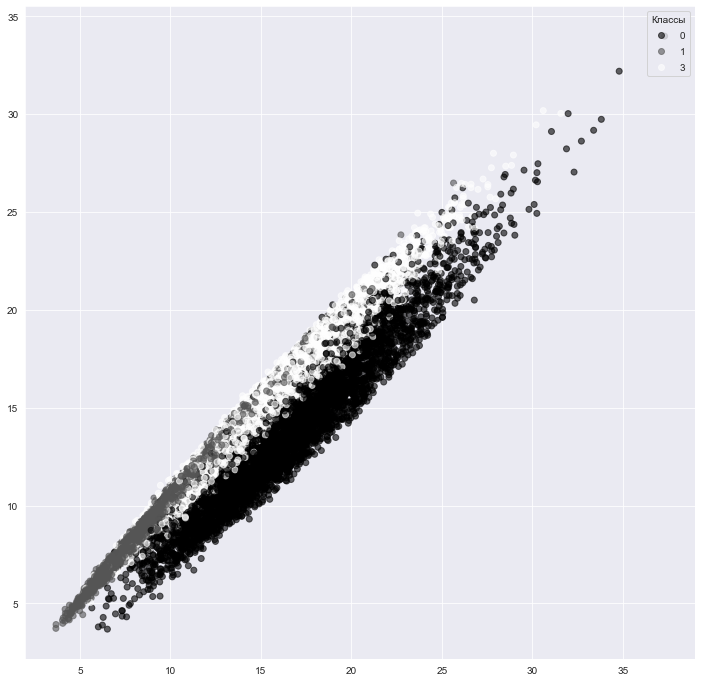

loss:  0.2844058573246002
________________________
*** ЭПОХА: 4 ***
________________________


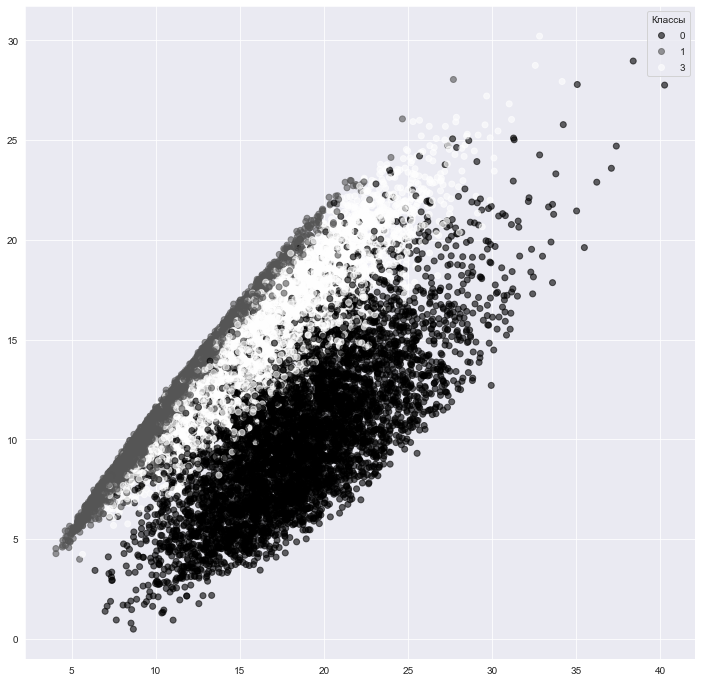

loss:  0.267610102891922
________________________
*** ЭПОХА: 5 ***
________________________


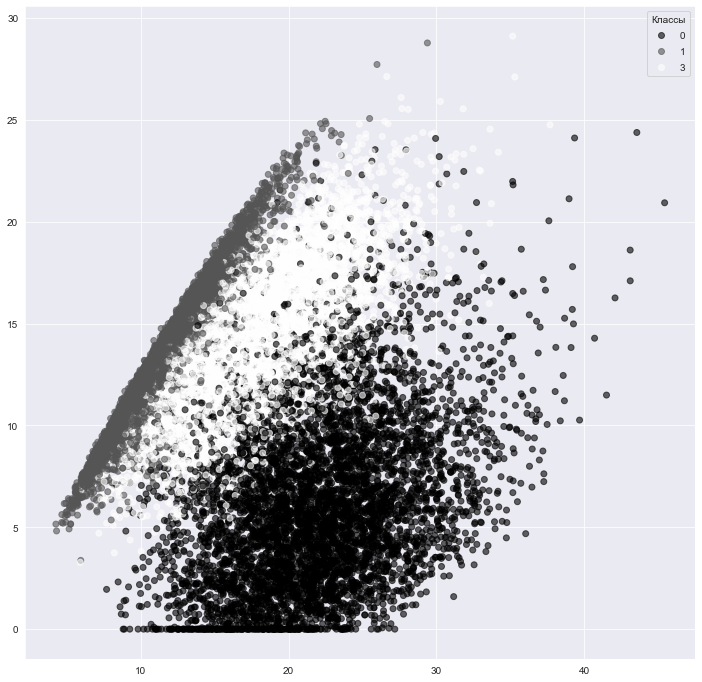

loss:  0.2451537847518921
________________________
*** ЭПОХА: 6 ***
________________________


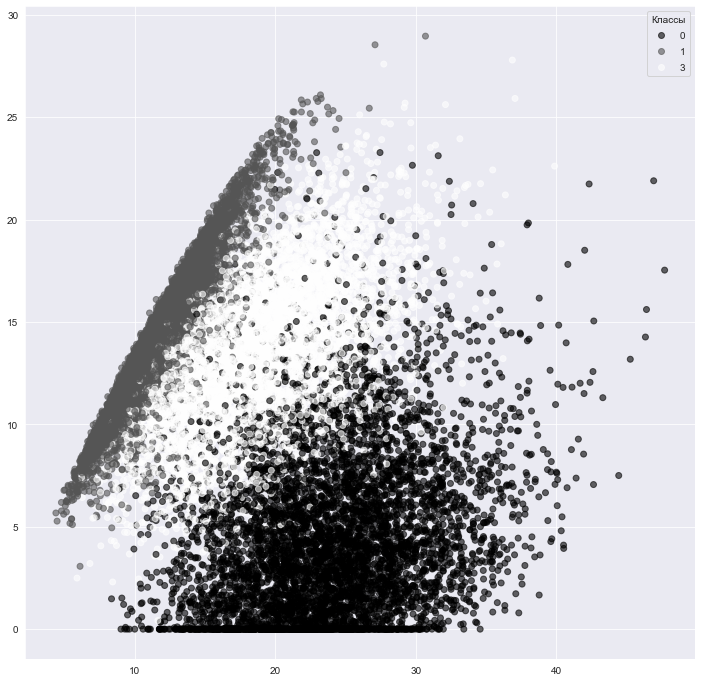

loss:  0.22881194949150085
________________________
*** ЭПОХА: 7 ***
________________________


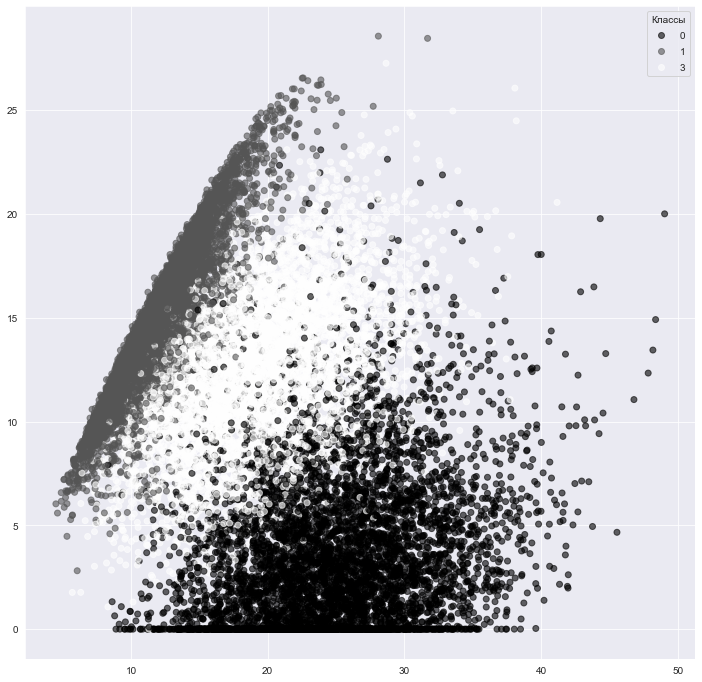

loss:  0.2222776710987091
________________________
*** ЭПОХА: 8 ***
________________________


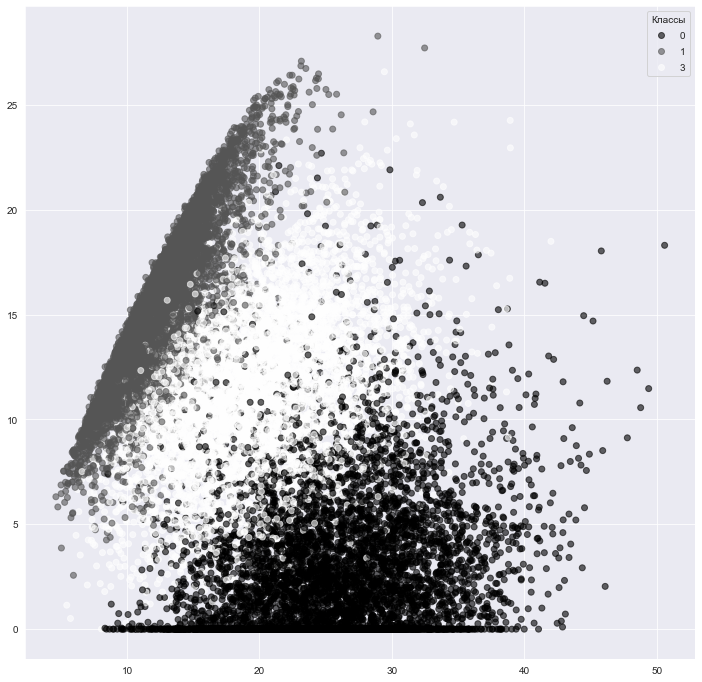

loss:  0.218601793050766
________________________
*** ЭПОХА: 9 ***
________________________


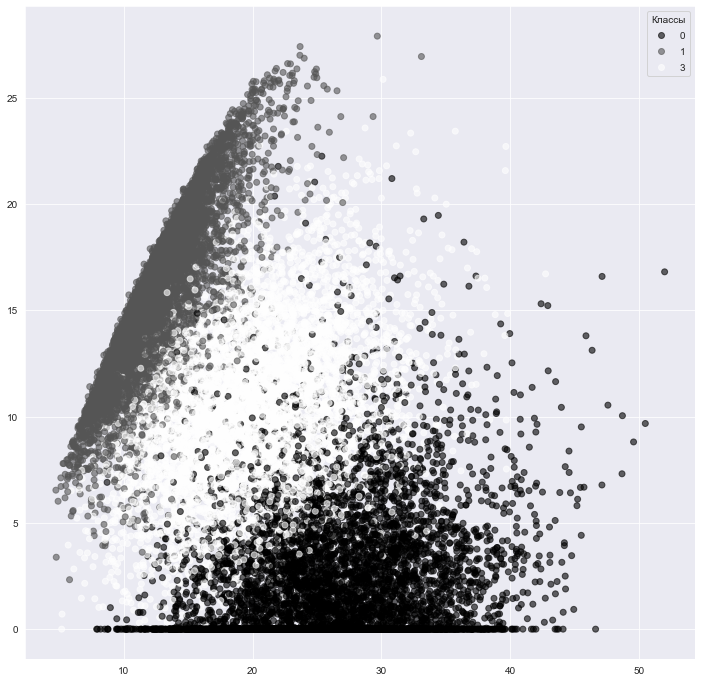

loss:  0.21603259444236755
________________________
*** ЭПОХА: 10 ***
________________________


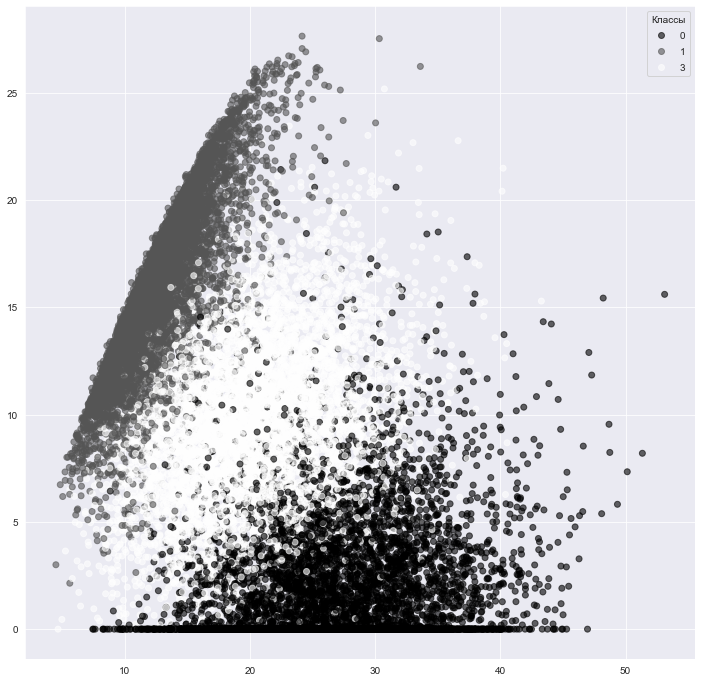

loss:  0.21412137150764465
________________________
*** ЭПОХА: 11 ***
________________________


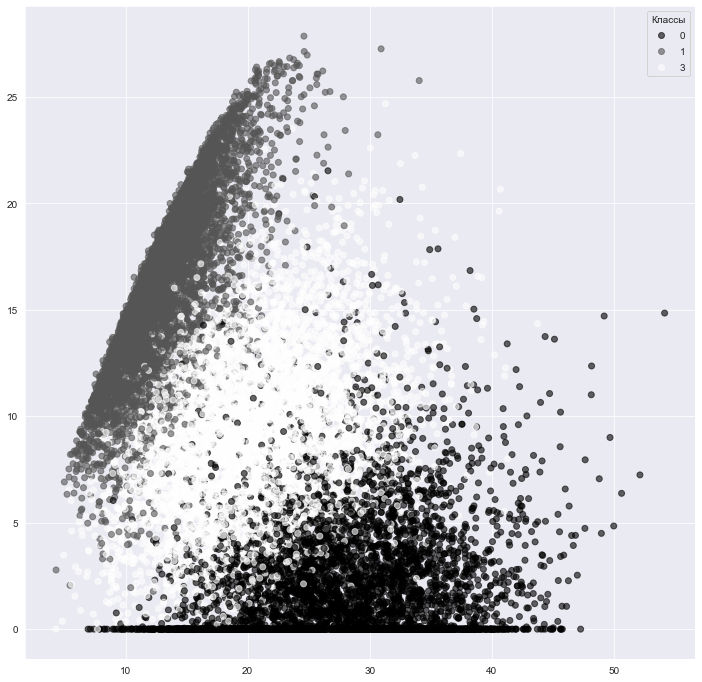

loss:  0.21265143156051636
________________________
*** ЭПОХА: 12 ***
________________________


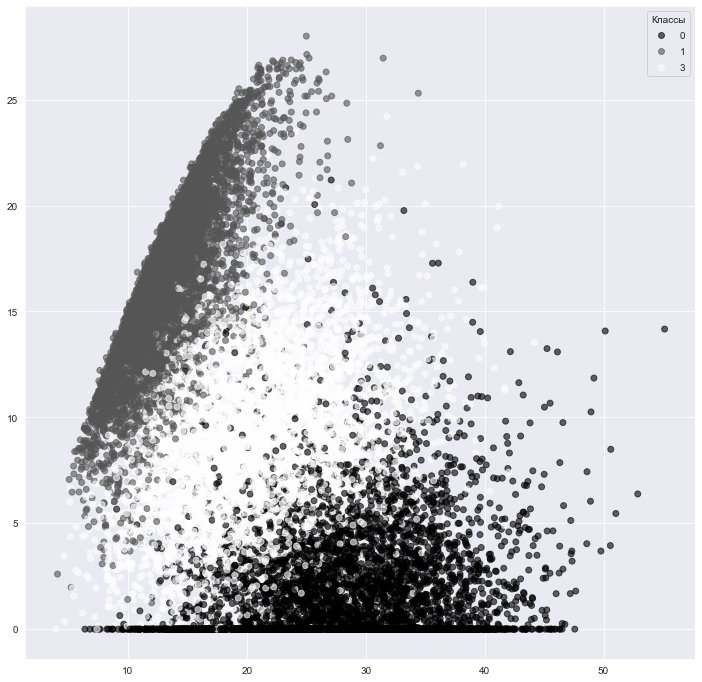

loss:  0.21146579086780548
________________________
*** ЭПОХА: 13 ***
________________________


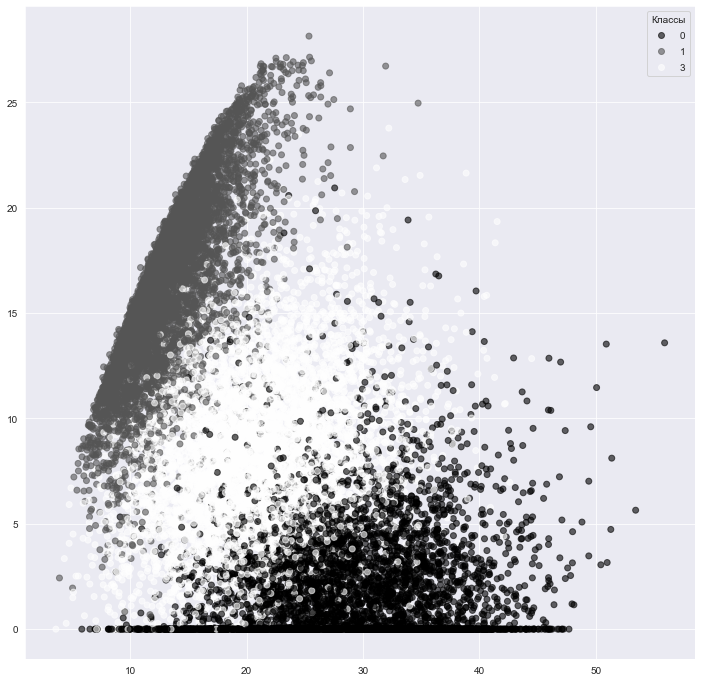

loss:  0.2104625403881073
________________________
*** ЭПОХА: 14 ***
________________________


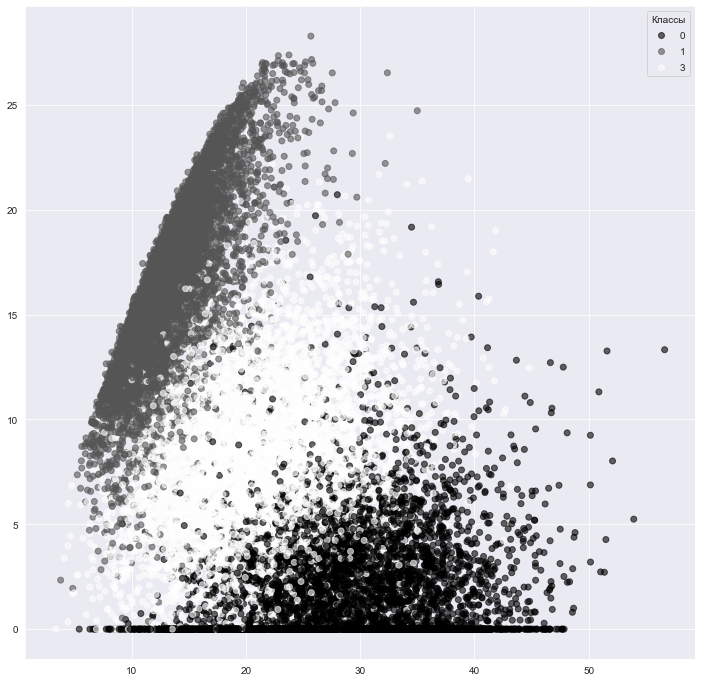

loss:  0.20960114896297455
________________________
*** ЭПОХА: 15 ***
________________________


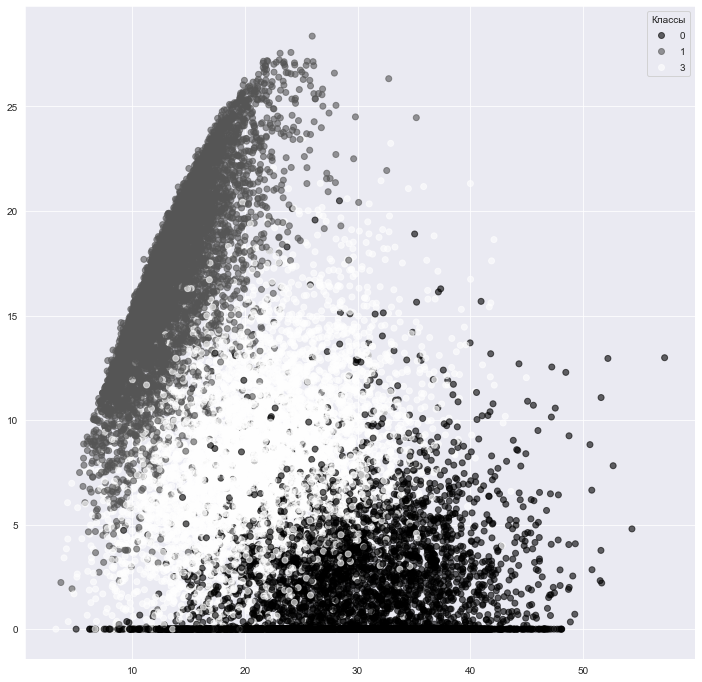

loss:  0.20884011685848236
________________________
*** ЭПОХА: 16 ***
________________________


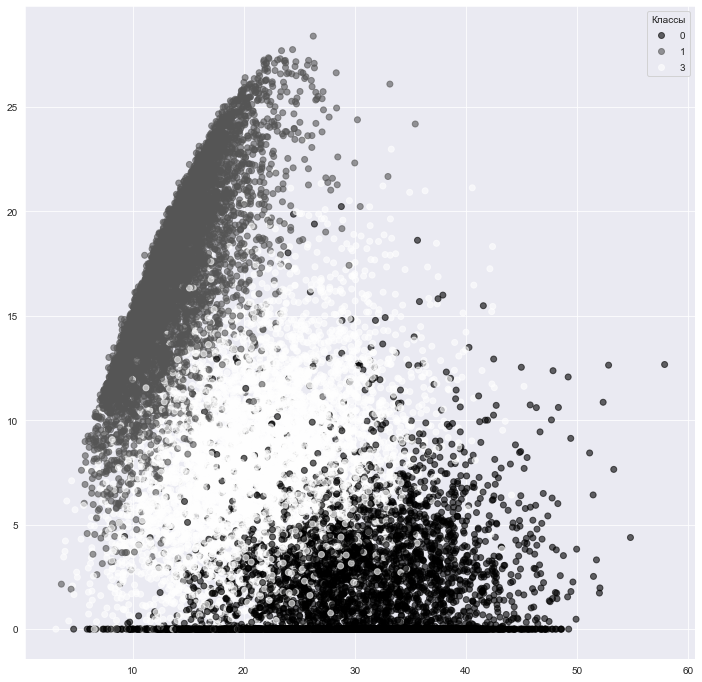

loss:  0.20815931260585785
________________________
*** ЭПОХА: 17 ***
________________________


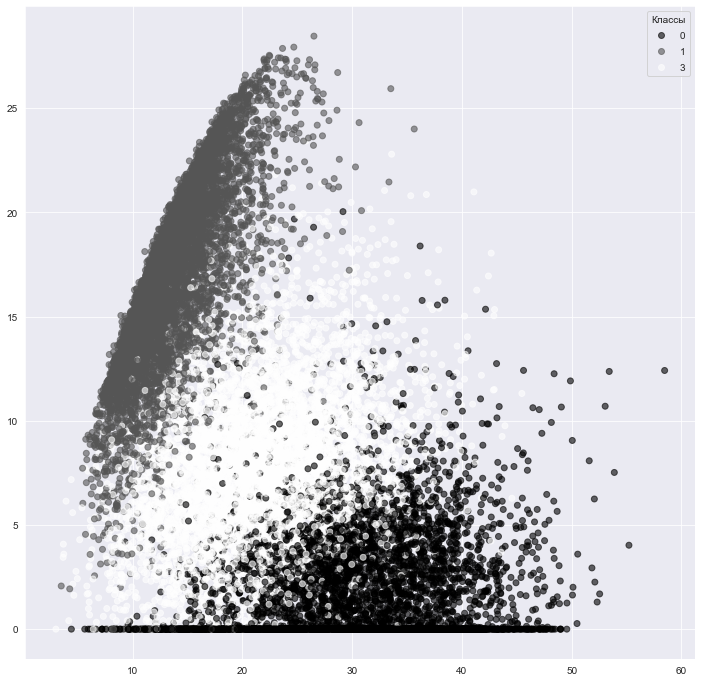

loss:  0.20754513144493103
________________________
*** ЭПОХА: 18 ***
________________________


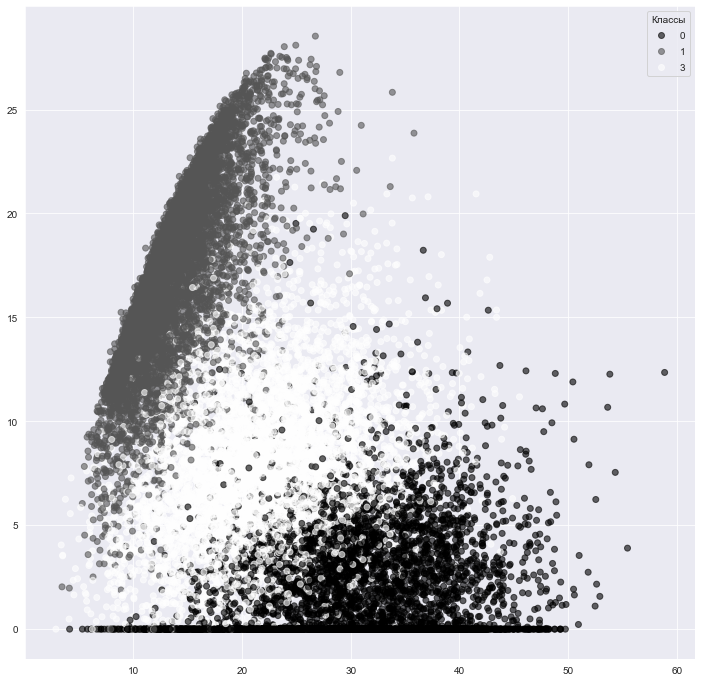

loss:  0.2069736123085022
________________________
*** ЭПОХА: 19 ***
________________________


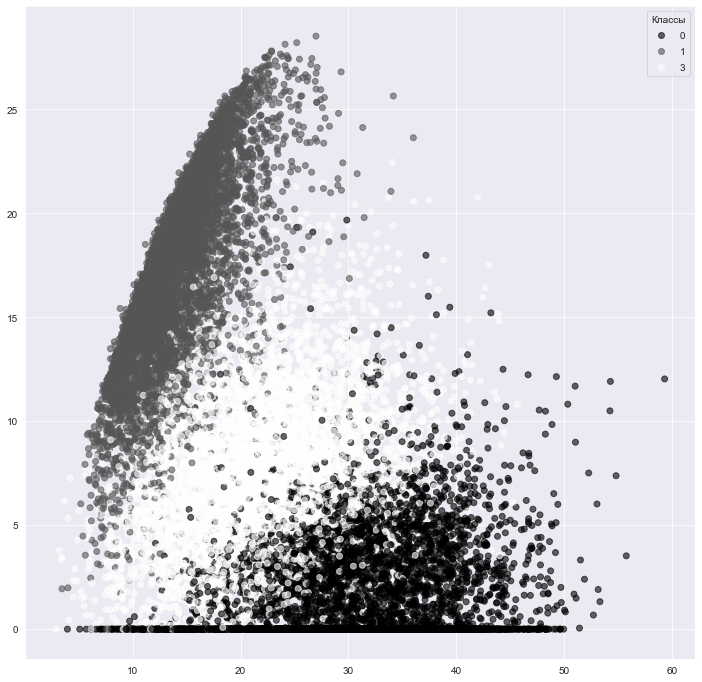

loss:  0.20643901824951172
________________________
*** ЭПОХА: 20 ***
________________________


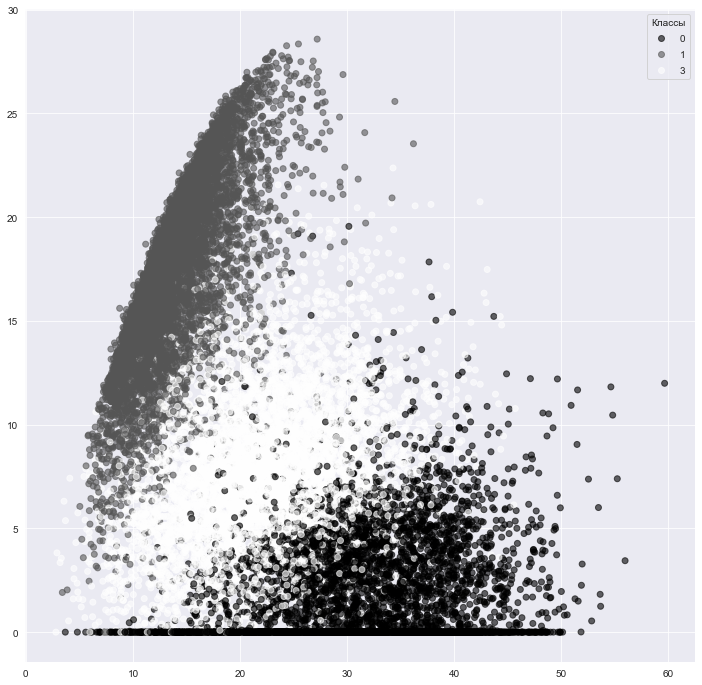

loss:  0.20595671236515045
________________________
*** ЭПОХА: 21 ***
________________________


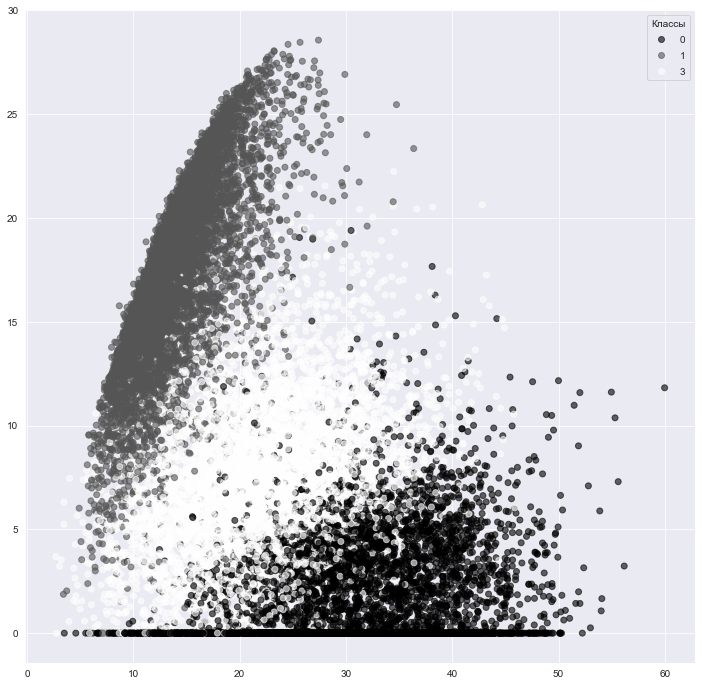

loss:  0.20551156997680664
________________________
*** ЭПОХА: 22 ***
________________________


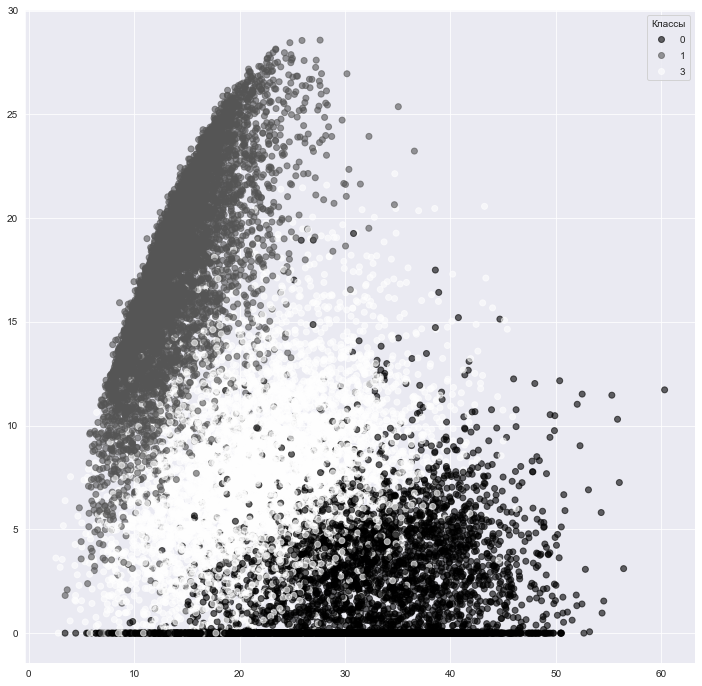

loss:  0.20507358014583588
________________________
*** ЭПОХА: 23 ***
________________________


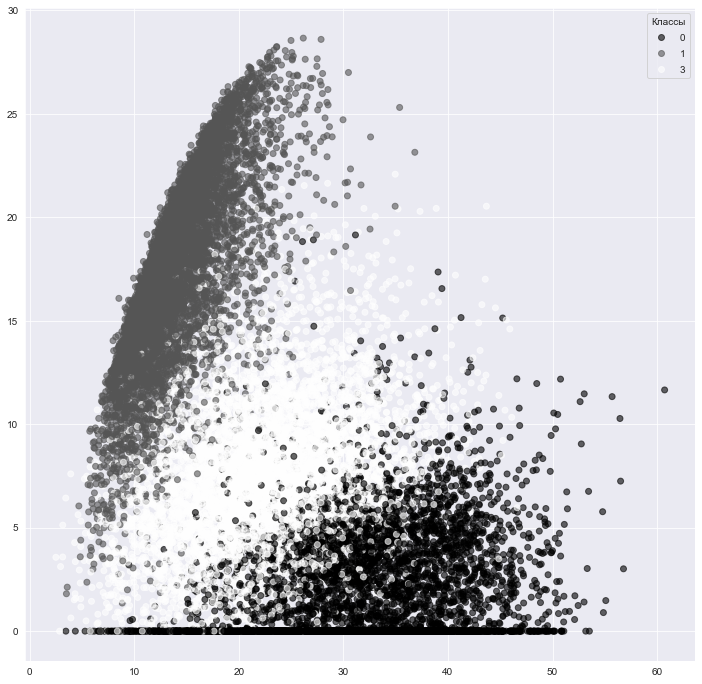

loss:  0.20465537905693054
________________________
*** ЭПОХА: 24 ***
________________________


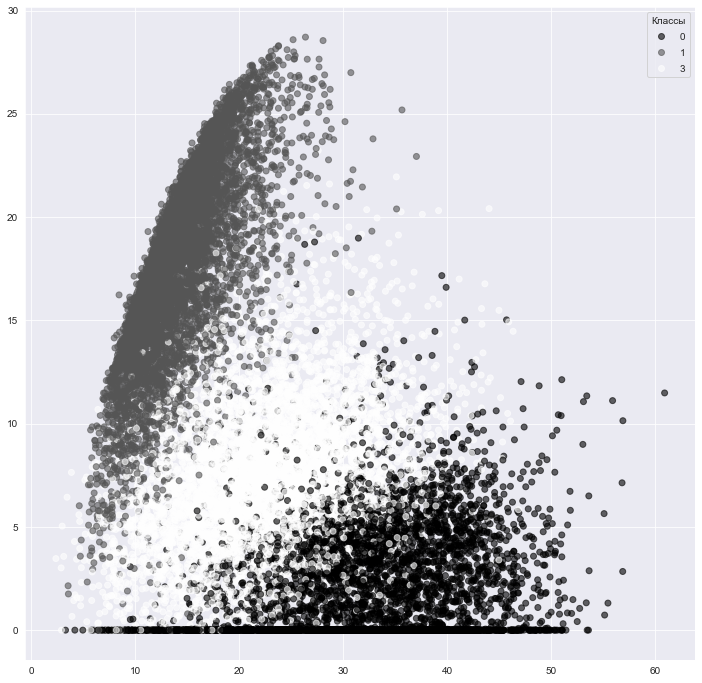

loss:  0.2042844593524933
________________________
*** ЭПОХА: 25 ***
________________________


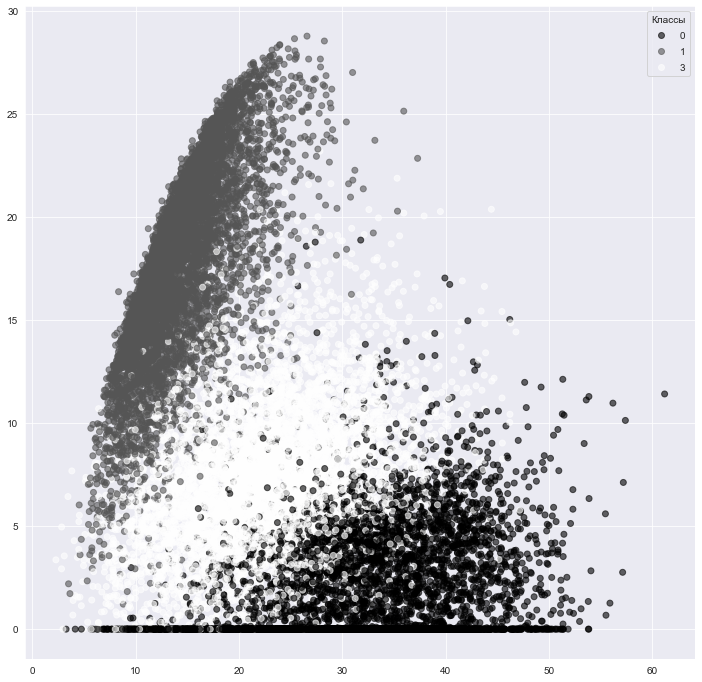

loss:  0.20391038060188293
________________________
*** ЭПОХА: 26 ***
________________________


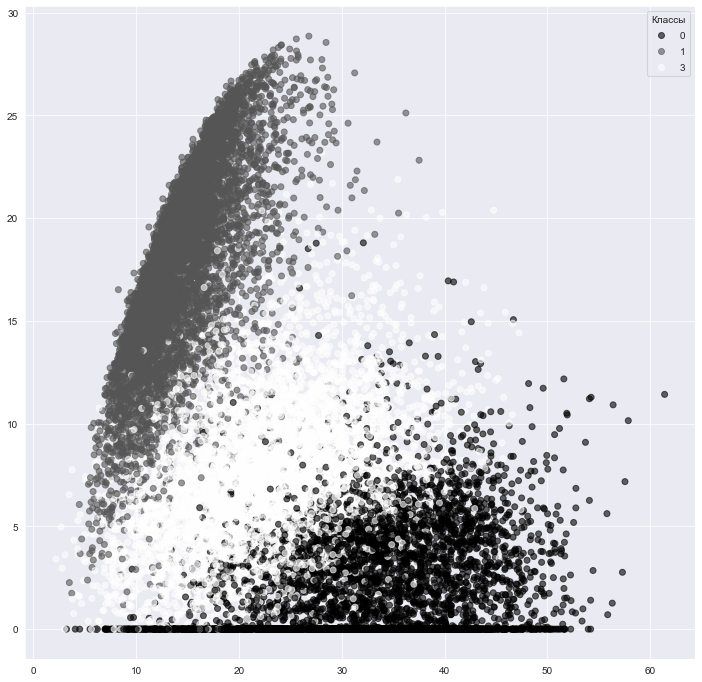

loss:  0.20354387164115906
________________________
*** ЭПОХА: 27 ***
________________________


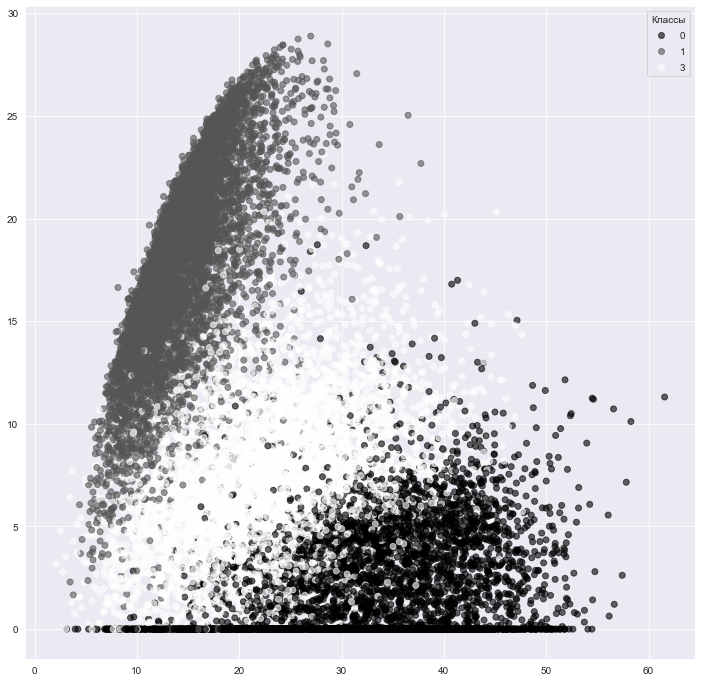

loss:  0.20323120057582855
________________________
*** ЭПОХА: 28 ***
________________________


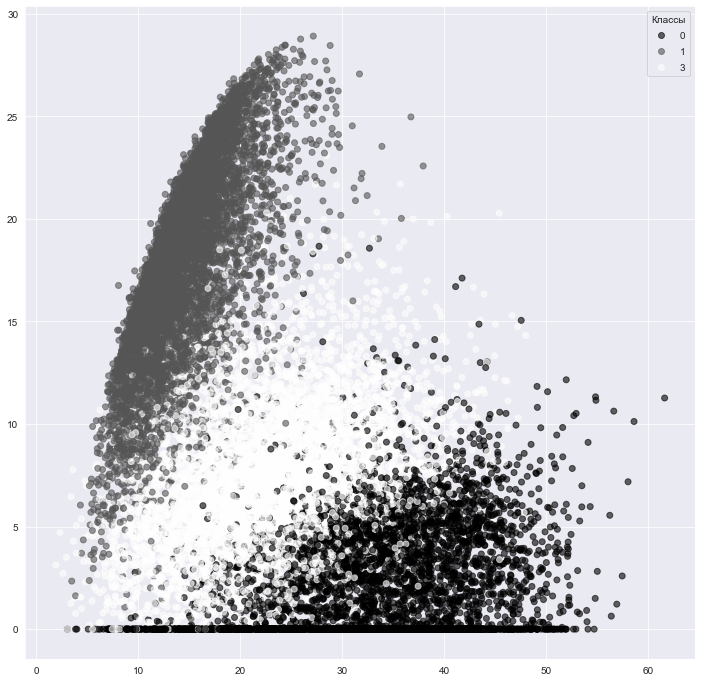

loss:  0.2029026448726654
________________________
*** ЭПОХА: 29 ***
________________________


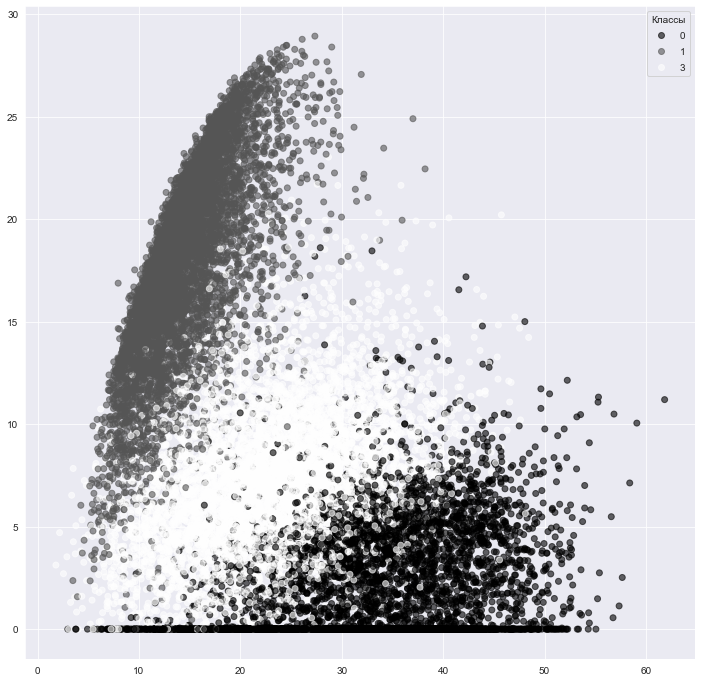

loss:  0.20260366797447205
________________________
*** ЭПОХА: 30 ***
________________________


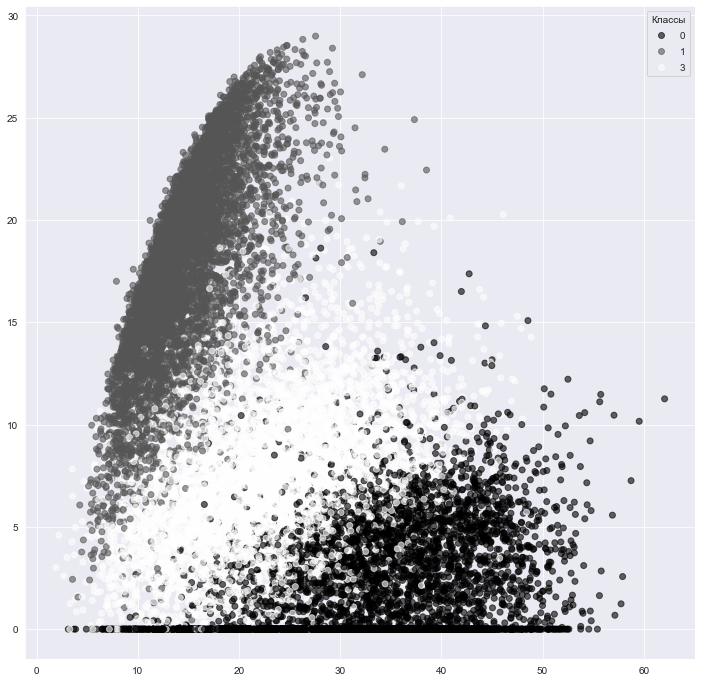

loss:  0.20229759812355042


In [98]:
# компилируем модель с выбранным оптимайзером и функцией потерь
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')  
classes = [0, 1, 3]
EPOCHS = 30
mask = np.array([(i in classes) for i in yTrainMnist])
new_x_train = xTrainMnist[mask]
new_y_train = yTrainMnist[mask]
autoencoder.fit(new_x_train, new_x_train,
                epochs=EPOCHS,
                batch_size=256,
                shuffle=True,
                callbacks = [pltAE],
                verbose=0)

In [99]:
koord = np.array([[17, 12]]) # Возьмем точку с указанными координатами
result = decoder.predict(koord) # Используя обученный декодер, попробуем восстановить исходное изображение
print(result.shape) # Выведем размер полученного тензора

(1, 28, 28, 1)


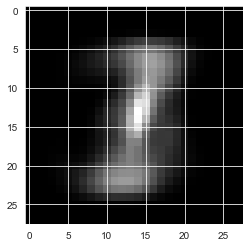

In [100]:
plt.imshow(result[0].reshape(28,28), cmap='gray') 
plt.show()

In [101]:
import imageio 
images = [] # список под изображения для gif
for i in range(30): 
    images.append(imageio.imread('image'+str(i)+'.jpg')) # Добавляем в список изображение очередную картинку
imageio.mimsave('AE.gif', images) # С помощью метода .mimsave() сохраняем анимацию

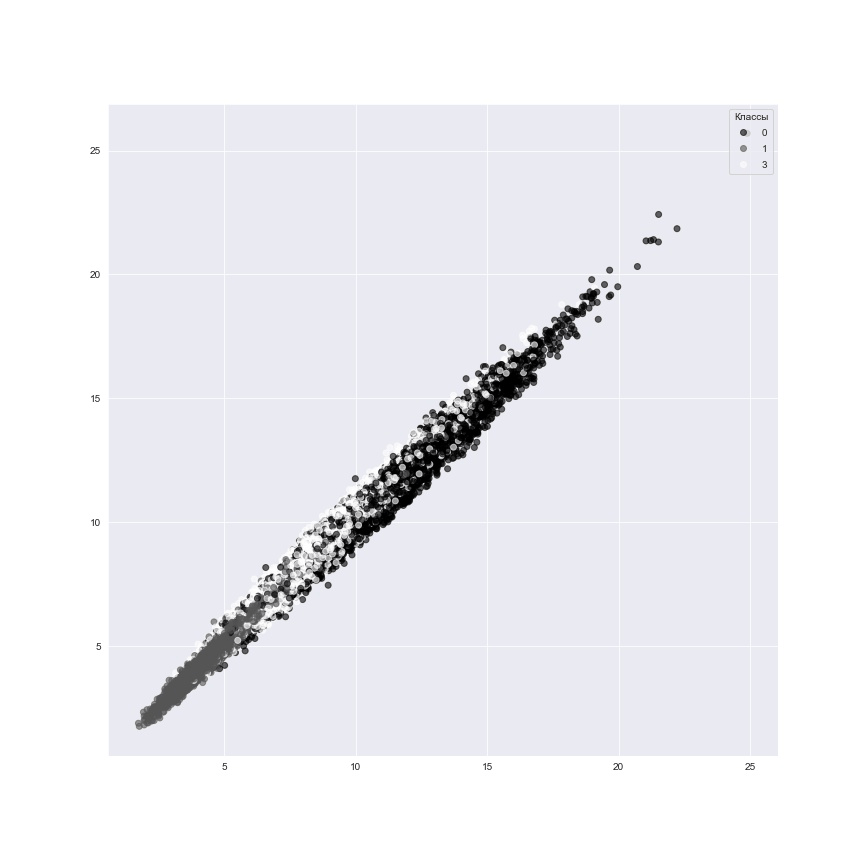

In [102]:
from IPython.display import Image 
Image(open('AE.gif','rb').read()) # Визуализируем анимацию

### Конец задания Ultra light

#### Определение мошеннических операций


In [44]:
df = pd.read_csv("/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_creditcard.csv")

In [103]:
df.head(2) 

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0


In [46]:
# Удаляем столбец со временем
data = df.drop(['Time'], axis=1)
# Нормализуем столбец с суммой транзакции
data['Amount'] = StandardScaler().fit_transform(data['Amount'].values.reshape(-1, 1))

frauds = data[data.Class == 1] # записываем мошеннические операции
normal = data[data.Class == 0] # записываем нормальные операции

In [47]:
frauds.shape 

(492, 30)

In [48]:
normal.shape 

(284315, 30)

In [49]:
RANDOM_SEED = 42 
X_train, X_test = train_test_split(normal, test_size=0.2, random_state=RANDOM_SEED)

In [50]:
# Удаляем класс в обучающем наборе данных
X_train = X_train.drop(['Class'], axis=1)
# Добавляем все мошеннические транзакции в тестовый набор данных
X_test = pd.concat([X_test, frauds])
# Делаем метки для тестового набора данных
y_test = X_test['Class']
# Удаляем класс у тестового набора данных
X_test = X_test.drop(['Class'], axis=1)
# Преобразуем данные в массивы numpy
X_train = X_train.values
X_test = X_test.values

In [51]:
print(X_train.shape)

(227452, 29)


In [52]:
def creditcardAutoencoder(): # объявляем автокодировщик для определения мошенич.транзакций
  dataSize = X_train.shape[1] # берём размеры X_train по второй оси(30)
  dataInput = Input(shape=(dataSize, )) # задаем эти размеры как входные в сеть
  
  x = Dense(10, activation='relu')(dataInput) # пропускаем через полносвязный слой размером 10
  x = Dense(dataSize, activation='linear')(x) # и через полносвязный слой размером 29 
  
  autoencoder = Model(inputs=dataInput, outputs=x) # собрали модель 
  
  autoencoder.compile(optimizer='Adam', loss='mse') # компилируем модель также, с выбором оптимайзера и среднеквадратичной ошибки
  
  return autoencoder 

In [53]:
model = creditcardAutoencoder()

In [54]:
history = model.fit(X_train, X_train,
                    epochs=10,
                    batch_size=32) # загружаем данные в модель(X_train'ы) и обучаем

Epoch 1/10
7108/7108 [==============================] - 6s 766us/step - loss: 0.4541
Epoch 2/10
7108/7108 [==============================] - 5s 728us/step - loss: 0.3584
Epoch 3/10
7108/7108 [==============================] - 5s 728us/step - loss: 0.3553
Epoch 4/10
7108/7108 [==============================] - 6s 798us/step - loss: 0.3547
Epoch 5/10
7108/7108 [==============================] - 6s 911us/step - loss: 0.3545
Epoch 6/10
7108/7108 [==============================] - 6s 881us/step - loss: 0.3545
Epoch 7/10
7108/7108 [==============================] - 5s 771us/step - loss: 0.3545
Epoch 8/10
7108/7108 [==============================] - 6s 845us/step - loss: 0.3543
Epoch 9/10
7108/7108 [==============================] - 6s 905us/step - loss: 0.3542
Epoch 10/10
7108/7108 [==============================] - 7s 926us/step - loss: 0.3543


In [55]:
model.save_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelCredit.h5')
model.load_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelCredit.h5')

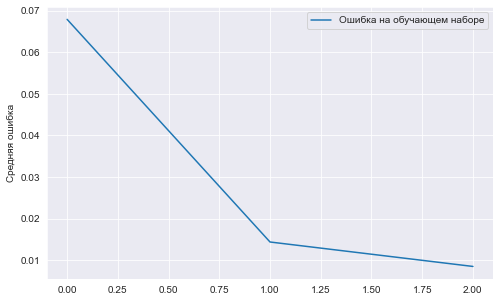

In [104]:
plt.figure(figsize=(8,5))
plt.plot(history.history['loss'][0:], 
         label='Ошибка на обучающем наборе')
plt.ylabel('Средняя ошибка')
plt.legend()
plt.show()

In [58]:
predictions = model.predict(X_test) 

In [59]:
mse = np.mean(np.power(X_test - predictions, 2), axis=1)

In [60]:
mse_normal = mse[y_test.values == 0] 
mse_frauds = mse[y_test.values == 1] 

In [61]:
print("Минимальная ошибка нормальных транзакций:", round(min(mse_normal),4)) 
print("Максимальная ошибка нормальных транзакций:", round(max(mse_normal),4)) 
print("Средняя ошибка нормальных транзакций:", round(sum(mse_normal) / len(mse_normal),4)) 

Минимальная ошибка нормальных транзакций: 0.0418
Максимальная ошибка нормальных транзакций: 322.3955
Средняя ошибка нормальных транзакций: 0.3542


In [62]:
print("Минимальная ошибка мошеннических транзакций:", round(min(mse_frauds),4)) 
print("Максимальная ошибка мошеннических транзакций:", round(max(mse_frauds),4)) 
print("Средняя ошибка мошеннических транзакций:", round(sum(mse_frauds) / len(mse_frauds),4)) 

Минимальная ошибка мошеннических транзакций: 0.156
Максимальная ошибка мошеннических транзакций: 101.8275
Средняя ошибка мошеннических транзакций: 19.0963


In [63]:
def getAccByBias(bias): # функция будет принимать какое то пороговое значение
  isNormal = mse_normal < bias # если ошибка меньше порога - то транзакция нормальная
  isFrauds = mse_frauds > bias # если ошибка больше порога - то транзакция мошенническая

  accNormal = sum(isNormal) / len(isNormal) # вычисляем процент нормальных операций
  accFaruds = sum(isFrauds) / len(isFrauds) # вычисляем процент мошеннических операций

  print("Распознано нормальных транзакций: ", round(100*accNormal), "%", sep="")
  print("Распознано мошеннических транзакций: ", round(100*accFaruds), "%", sep="")
  print("Средняя точность распознавания: ", round(50*(accNormal + accFaruds)), "%", sep="")

In [64]:
getAccByBias(0.65) # выведем данные по распознаванию с конкретным пороговым значением

Распознано нормальных транзакций: 93%
Распознано мошеннических транзакций: 90%
Средняя точность распознавания: 91%
